# Computer exercise 3: Exploratory data analysis, part I

Exploratory data analysis (EDA) is a process in which we summarise and visually explore a dataset. Unlike statistical hypothesis testing, which is used to reject hypotheses, EDA can be used to generate hypotheses (which can then be confirmed by new studies). Another purpose of EDA is to find outliers and incorrect observations, which can lead to a cleaner and more useful dataset. In EDA we ask questions about our data, and then try to answer them using summary statistics and graphics. Some questions will prove to be
important, and some will not. The key to finding the important questions is to ask many questions.
In this computer exercise, we will focus on univariate EDA and comparisons between groups. In the next exercise, we will instead focus on multivariate analyses.

In [31]:
install.packages("ggridges")

Updating HTML index of packages in '.Library'
Making 'packages.html' ... done


In [70]:
library(ggplot2) 
library(plotly)
library(ggridges)
library(dplyr)
library(nycflights13)
library(dplyr)

In [32]:
library(ggridges)

In this exercise, we will study the following datasets from the ggplot2 and nycflights13 packages:

• diamonds: describing the prices of more than 50,000 cut diamonds; from ggplot2.

• flights: describing information about flights to and from New York; from nycflights13. 

• msleep: describing the sleep times of 83 mammals; from ggplot2

## Exploring distributions

It is often useful to visualise the distribution of a numerical variable. Comparing the distributions of different groups can lead to important insights. Visualising distributions is also important when checking assumptions using for various statistical tests (sometimes called initial data analysis).

### Density plots and frequency polygons 

We already know how to visualise the distribution of the data by dividing it into bins it and plotting a histogram:

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


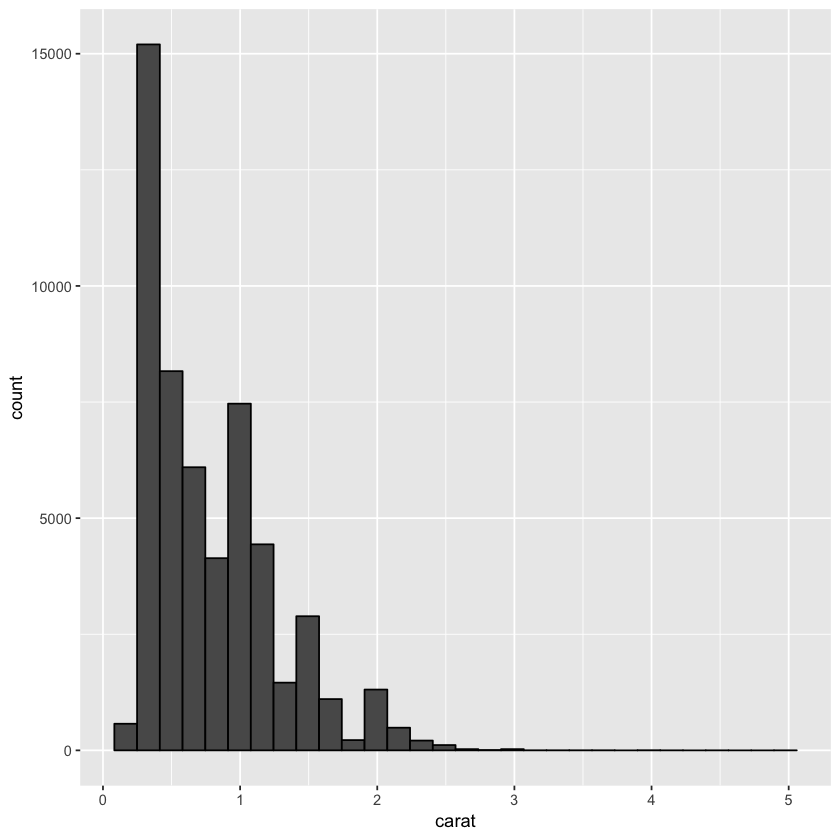

In [12]:
 ggplot(diamonds, aes(carat)) + geom_histogram(colour = "black")

A similar plot is created using frequency polygons, which uses lines instead of bars to display the counts in the bins:

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


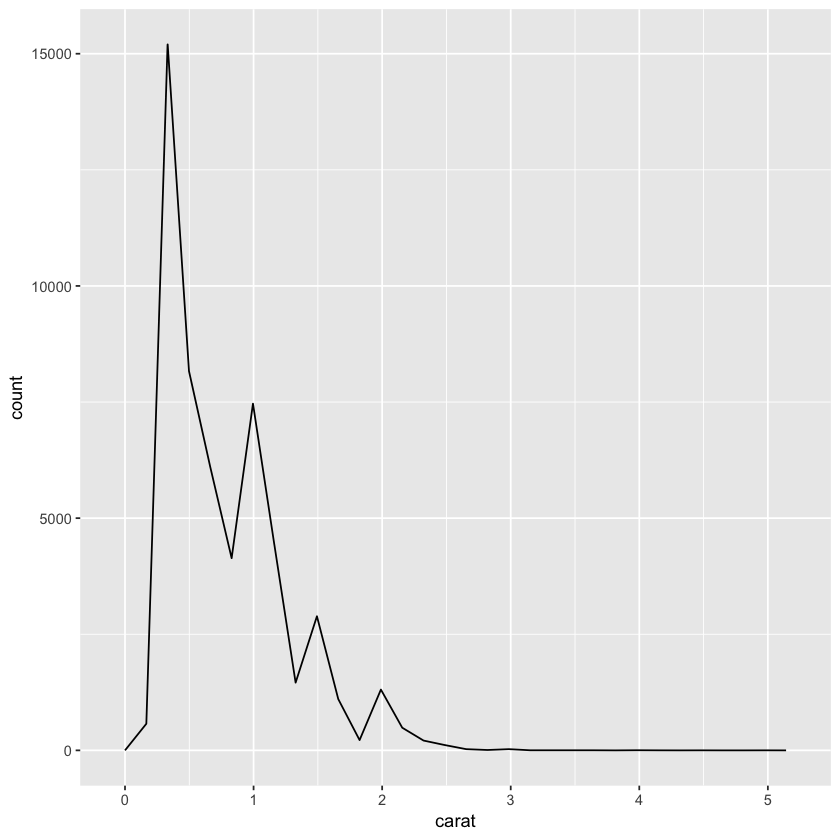

In [13]:
ggplot(diamonds, aes(carat)) + geom_freqpoly()

An advantage with frequency polygons is that they can be used to compare groups, e.g. diamonds with different cuts, without facetting:

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


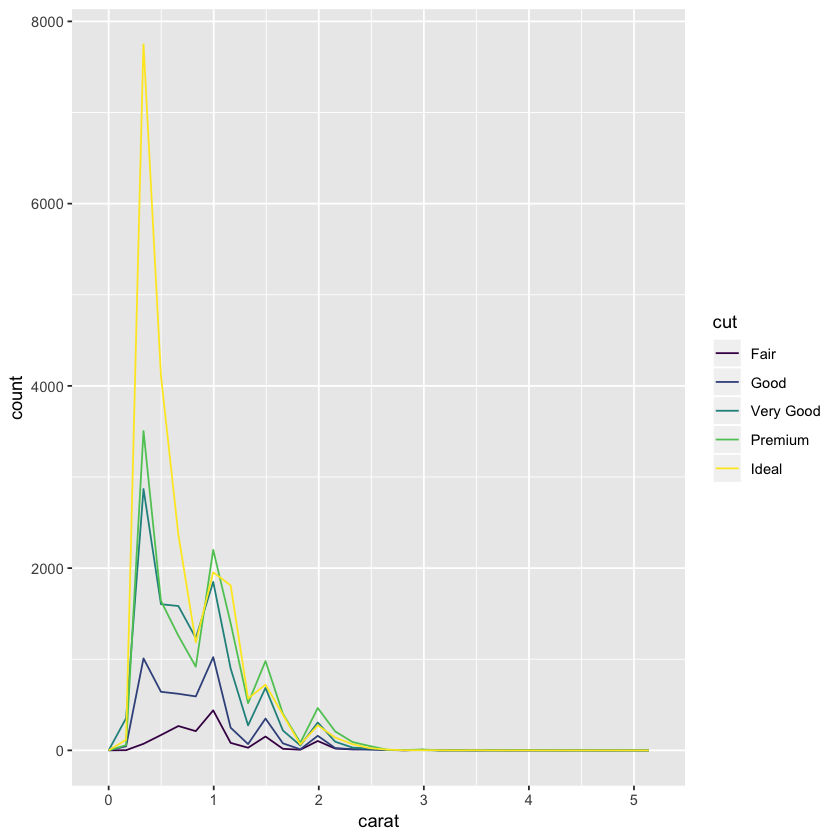

In [14]:
ggplot(diamonds, aes(carat, colour = cut)) + geom_freqpoly()

It is clear from this figure that there are more diamonds with ideal cuts than diamonds with fair cuts in the data. The polygons have roughly the same shape, except perhaps for the polygon for diamonds with fair cuts.


In some cases we are more interested in the shape of the distribution that in the actual counts in the different bins. Density plots are similar to frequency polygons, but show an estimate of the density function of the underlying random variable. These estimates are smooth curves that are scaled so that the area below them is 1 (i.e. scaled to be proper density functions):

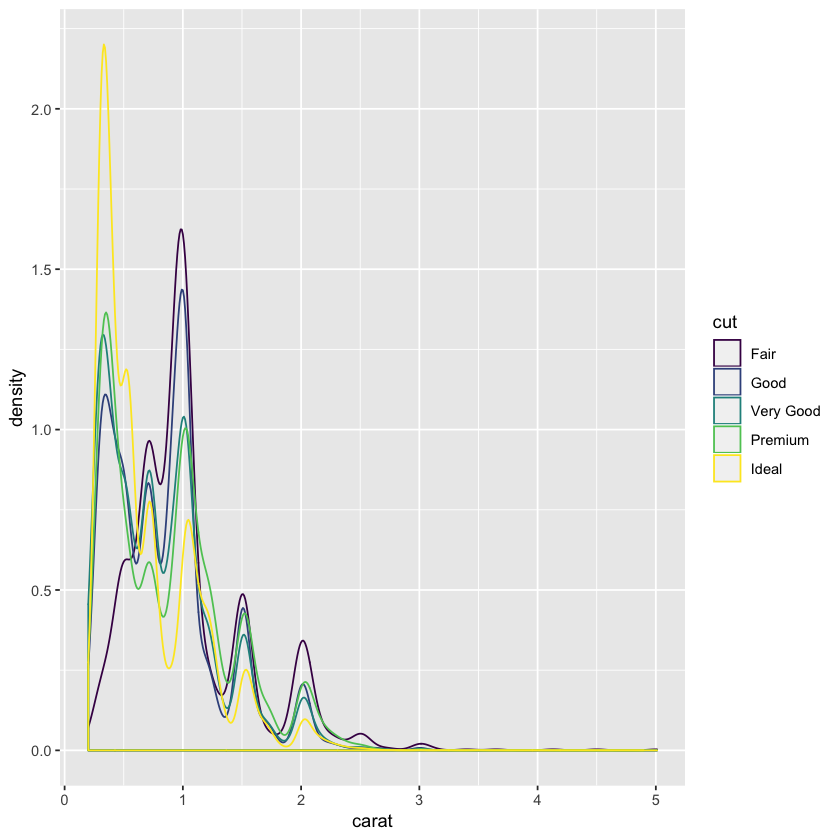

In [15]:
ggplot(diamonds, aes(carat, colour = cut)) + geom_density()

From this figure, it becomes clear that low-carat diamonds tend to have better cuts, which wasn’t obvious from the frequency polygons. However, the plot does not provide any information about how common different cuts are.

### Exercise 1

Using the density plot created above and the documentation for geom_density, do the following:

1. Increase the smoothness of the density curves.

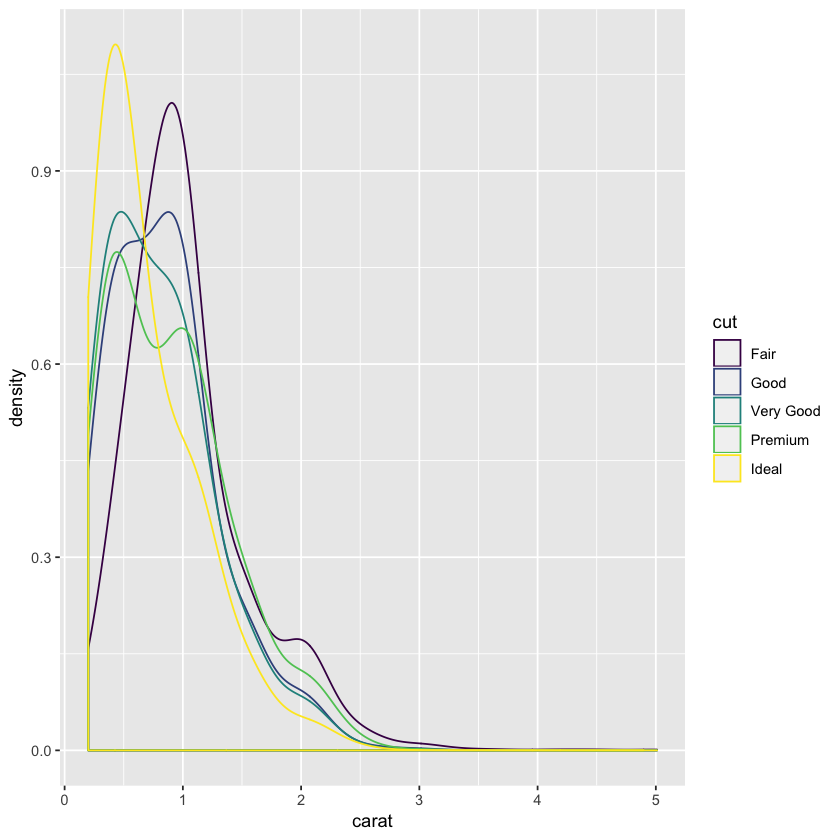

In [16]:
ggplot(diamonds, aes(carat, colour = cut)) + geom_density(bw = 0.2)

2. Fill the area under the density curves with the same colour as the curves themselves.

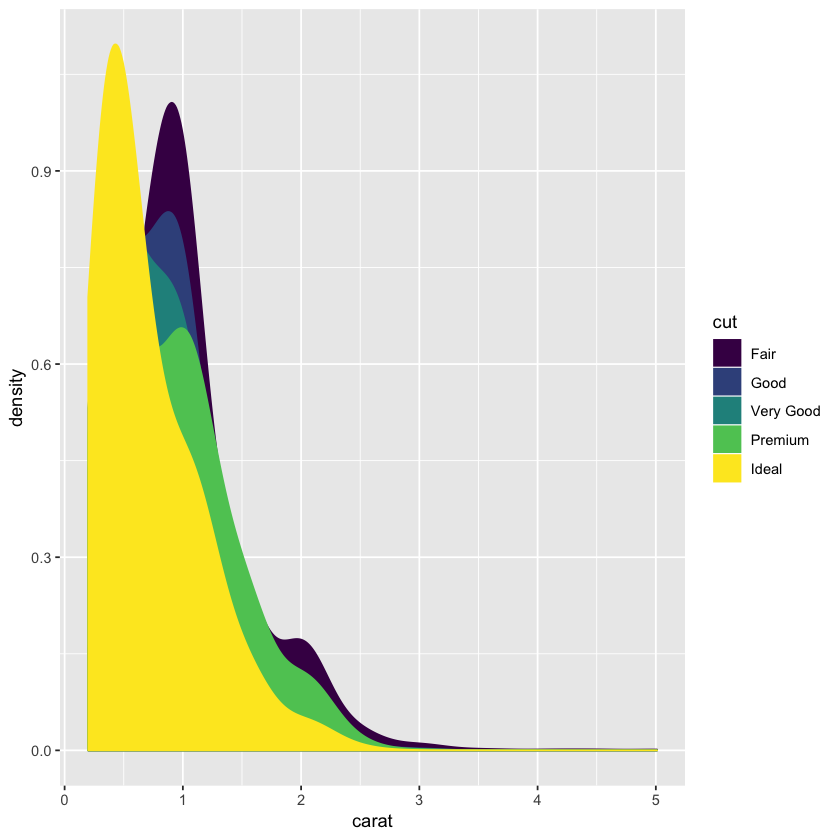

In [17]:
ggplot(diamonds, aes(carat, colour = cut, fill = cut)) + geom_density(bw = 0.2)

3. Make the colours that fill the areas under the curves transparent.

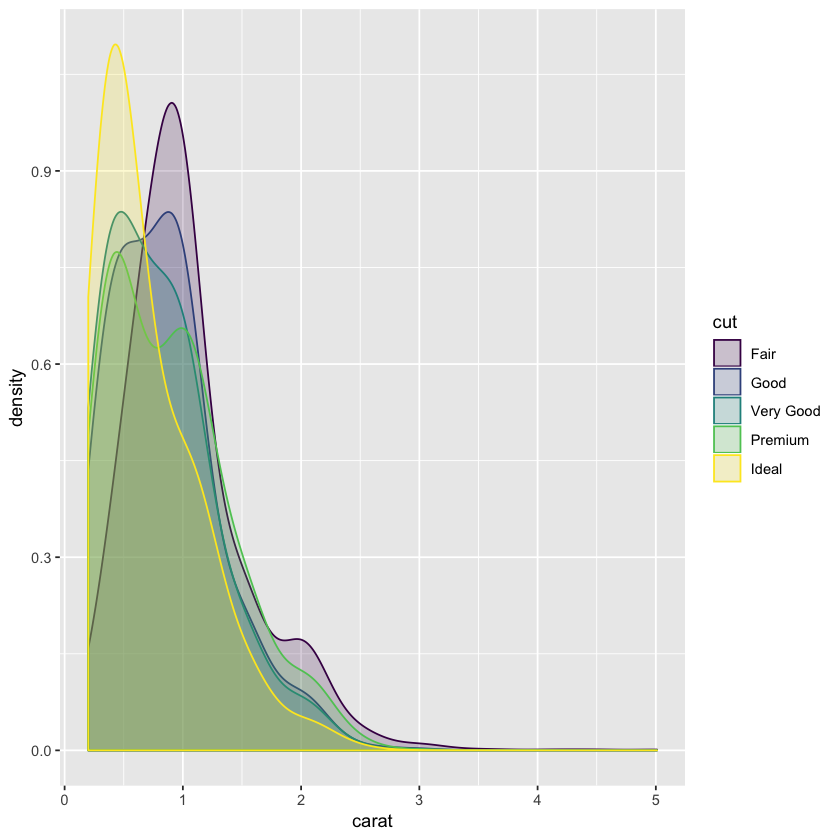

In [29]:
ggplot(diamonds, aes(carat, colour = cut, fill = cut)) + geom_density(bw = 0.2, alpha = 0.2)

4. The figure still isn’t that easy to interpret. Load the ggridges package, which is an extension of ggplot2 that allows you to make so-called ridge plots (density plots that are separated along the y-axis, similar to facetting). Read the documentation for geom_density_ridges and use it to make a ridge plot of diamond prices for different cuts.

In [33]:
ggplot(diamonds, aes(carat, cut, fill = cut)) + geom_density_ridges()

Warning message in eval(expr, envir, enclos):
“restarting interrupted promise evaluation”Warning message in eval(expr, envir, enclos):
“internal error -3 in R_decompress1”

ERROR: Error in eval(expr, envir, enclos): lazy-load database '/opt/anaconda3/envs/DataAnalysis/lib/R/library/ggridges/R/ggridges.rdb' is corrupt


Exercise 2

Return to the histogram created by ggplot(diamonds, aes(carat)) + geom_histogram() above. As there are very few diamonds with carat greater than 3, cut the x-axis at 3. Then decrease the bin width to 0.01. Do any interesting patterns emerge?

Warning message:
“Removed 32 rows containing non-finite values (stat_bin).”Warning message:
“Removed 2 rows containing missing values (geom_bar).”

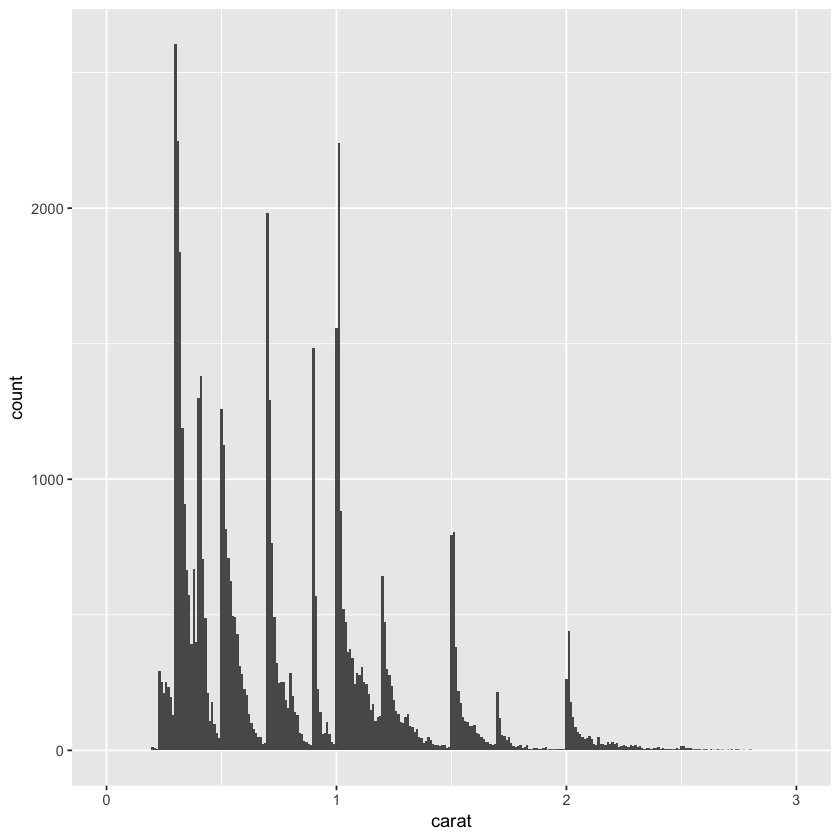

In [34]:
ggplot(diamonds, aes(carat)) + geom_histogram(binwidth = 0.01) + xlim(0, 3)

Asking questions

Exercise 2 causes us to ask why diamonds with carat values that are multiples of 0.25 are more common that others. Perhaps price is involved? Unfortunately, a plot of carat versus price is not that informative:

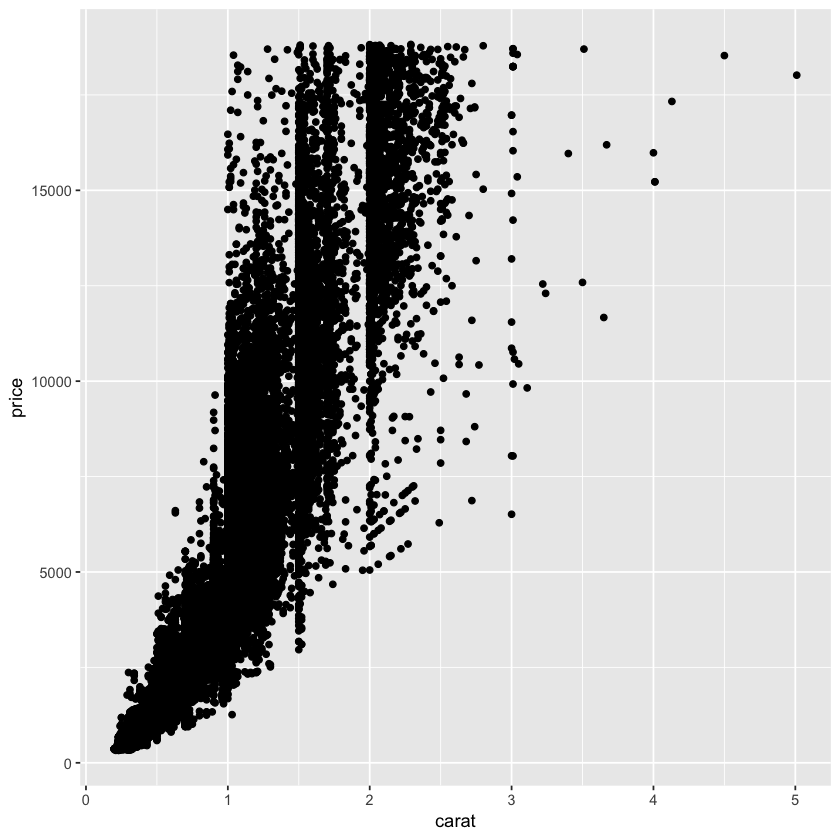

In [35]:
ggplot(diamonds, aes(carat, price)) + geom_point()

Another option is to compute the average price in each bin of the histogram. In order to do so, we must
1
 ggplot(diamonds, aes(carat, price)) + geom_point()
extract the bin breaks from the plot object. This is beyond the standard use of ggplot2 . The bins are extracted using ggplot_build(myPlot)$data[[1]], x), where ggplot_build is an internal function in the ggplot2 package that is part of creating a plot. Finally, we make use of the dplyr package to compute the mean in each bin.

In [37]:
# Create the histogram and save it as a variable
myPlot <- ggplot(diamonds, aes(carat)) + geom_histogram(binwidth = 0.01) + xlim(0, 3)

In [39]:
# A function for computing the mean price in a bin
mean_bin_func <- function(df) {
filter(diamonds, carat > df$xmin & carat <= df$xmax) %>% 
    summarise(mean_price = mean(price), ct = df$count[1]) %>% 
    mutate(mean_price = ifelse(is.nan(mean_price), NA, mean_price))
}

In [41]:
# Extract the bin breaks using ggplot_build, then compute the means
bin_means <- group_by(ggplot_build(myPlot)$data[[1]], x) %>% do(mean_bin_func(.)) %>% ungroup()

Warning message:
“Removed 32 rows containing non-finite values (stat_bin).”

Warning message:
“Removed 46 rows containing missing values (geom_point).”

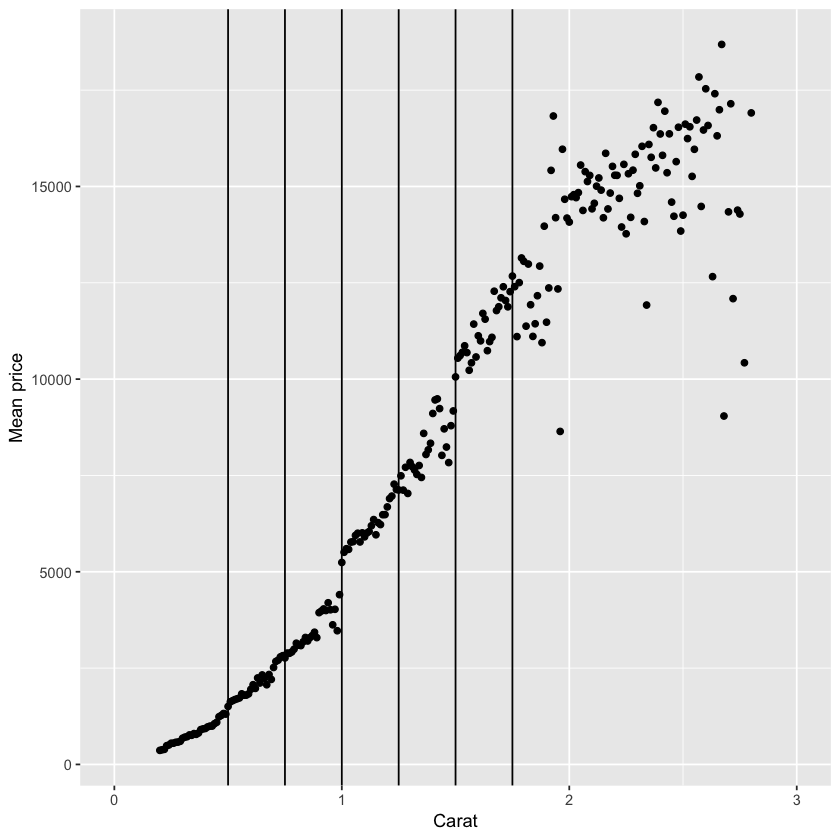

In [43]:
# Plot the mean prices as a scatterplot
# Add vertical lines at some multiples of 0.25 to aid the eye 
ggplot(bin_means, aes(x, mean_price)) +
geom_point() +
xlab("Carat") +
ylab("Mean price") +
geom_vline(xintercept = 0.5) + 
geom_vline(xintercept = 0.75) + 
geom_vline(xintercept = 1) + 
geom_vline(xintercept = 1.25) + 
geom_vline(xintercept = 1.5) + 
geom_vline(xintercept = 1.75)

It appears that there are small jumps in the prices at at least some of the 0.25-marks. This explains why there are more diamonds just above these marks than just below.

The above example illustrates two important things regarding exploratory data analysis:

• Plots (in our case, the histogram) often lead to new questions.

• A lot of the time we must manipulate (transform, summarise, etc.) our data to answer a question. Sometimes this is straightforward and sometimes it mean diving deep into R code. If you are unsure about how to do something, do a web search.

Violin plots

Density curves can also be used as alternatives to boxplots. In computer exercise 1, you created boxplots to visualise price differences between diamonds of different cuts:

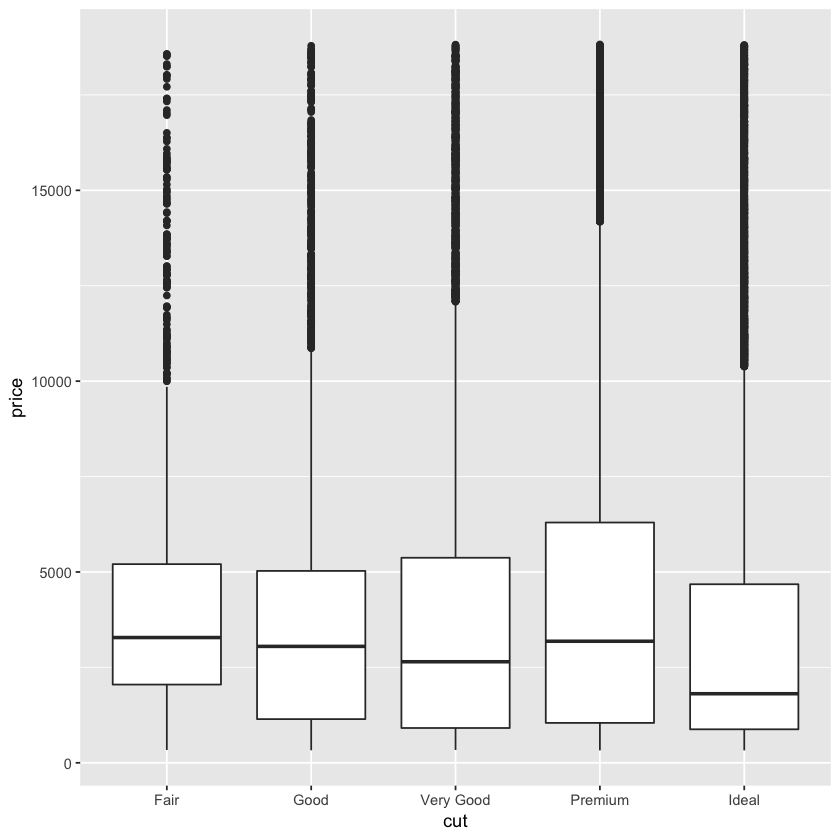

In [46]:
ggplot(diamonds, aes(cut, price)) + geom_boxplot()

Instead of using a boxplot, we can use a violin plot. Each group is represented by a “violin”, given by a rotated and duplicated density plot:

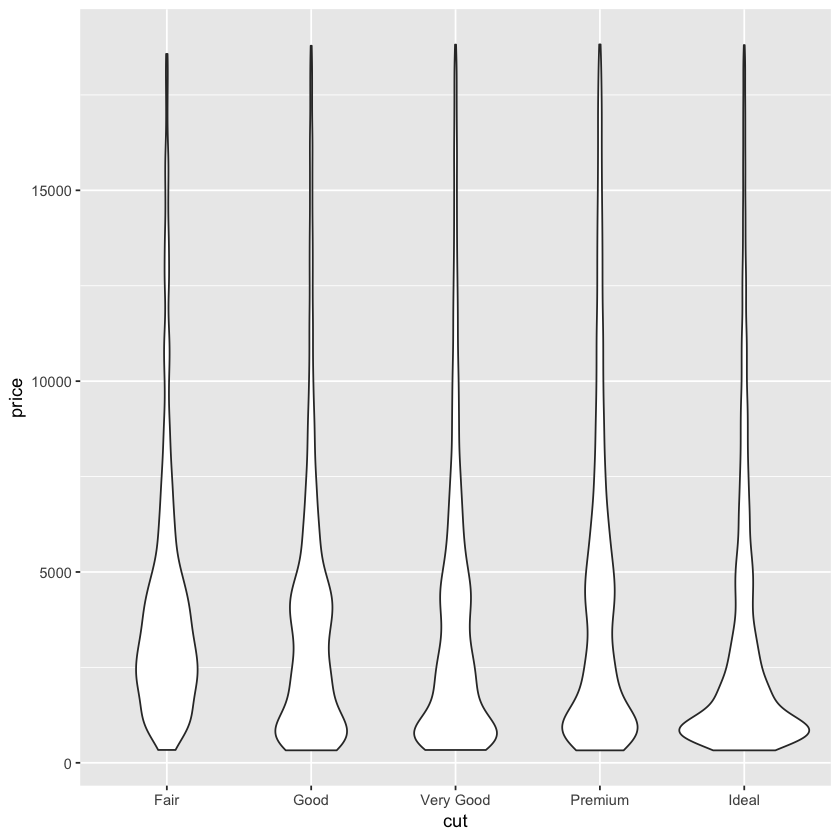

In [45]:
ggplot(diamonds, aes(cut, price)) + geom_violin()

Compared to boxplots, violin plots capture the entire distribution of the data rather than just a few numerical summaries. If you like numerical summaries (and you should!) you can add the median and the quartiles
(corresponding to the borders of the box in the boxplot) using the draw_quantiles argument:

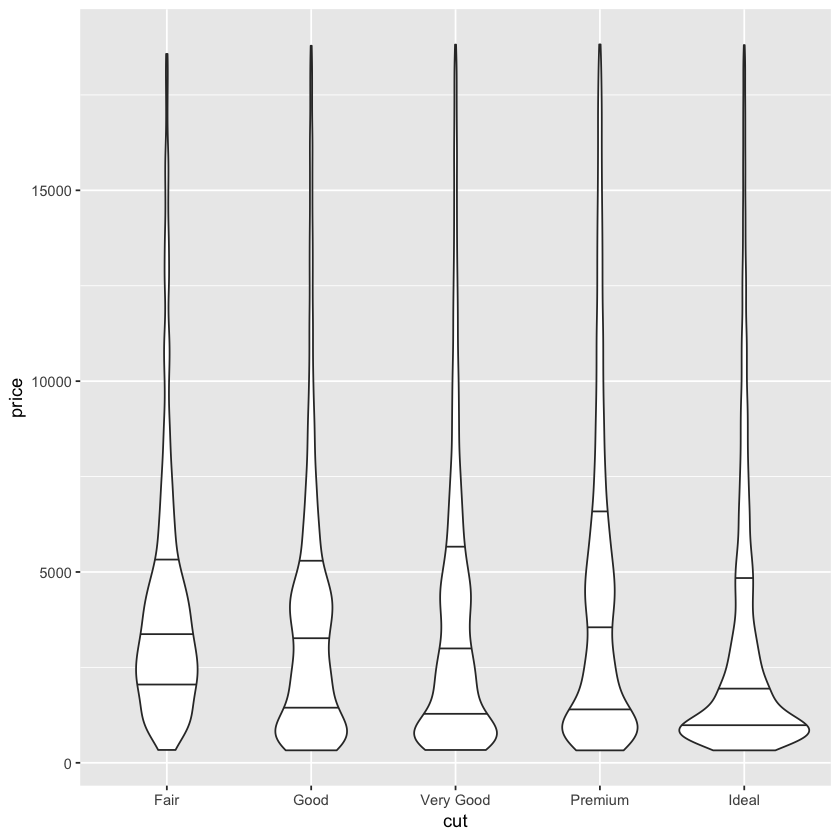

In [47]:
ggplot(diamonds, aes(cut, price)) + geom_violin(draw_quantiles = c(0.25, 0.5, 0.75))

### Exercise 3

Using the first boxplot create above, i.e. ggplot(diamonds, aes(cut, price)) + geom_violin(), do the following:

1. Add some colour to the plot by giving different colours to each violin.

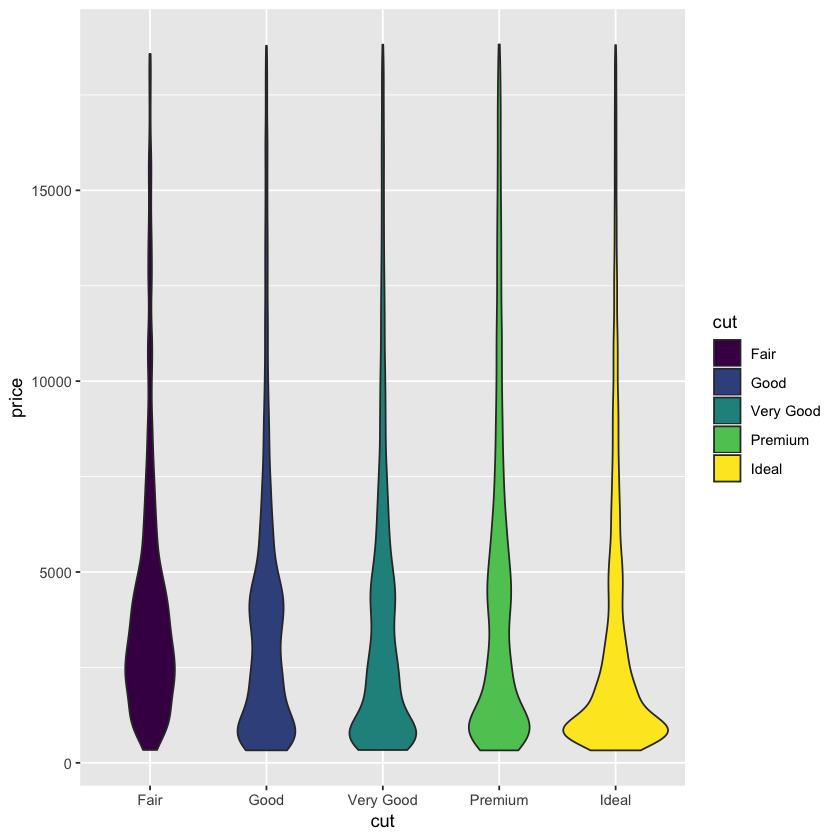

In [48]:
ggplot(diamonds, aes(cut, price, fill = cut)) + geom_violin()

2. Because the categories are shown along the x-axis, we don’t really need the legend. Add
theme(legend.position="none") to the plot to remove the legend.

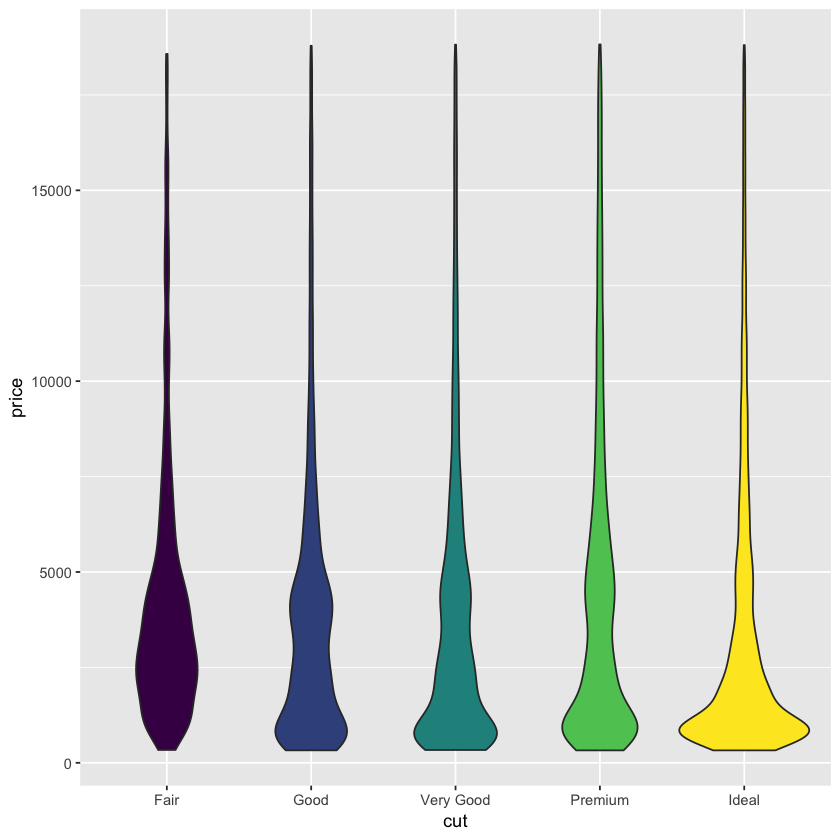

In [49]:
ggplot(diamonds, aes(cut, price, fill = cut)) + geom_violin() +
theme(legend.position = "none")

3. Both boxplots and violin plots are useful. Maybe we can have the best of both worlds? Add the corresponding boxplot inside each violin. Hint: the width and alpha arguments in geom_boxplot are useful for creating a nice-looking figure here.

Warning message:
“position_dodge requires non-overlapping x intervals”

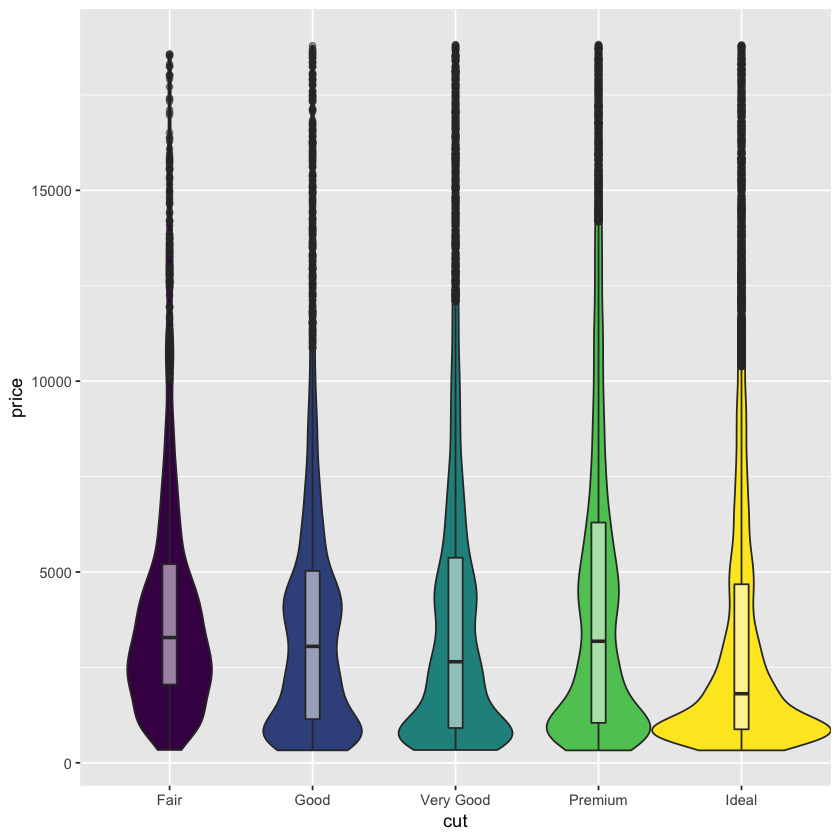

In [50]:
ggplot(diamonds, aes(cut, price)) + 
geom_violin(aes(fill = cut), width = 1.25) + 
geom_boxplot(width = 0.1, alpha = 0.5) + 
theme(legend.position = "none")

4. Flip the coordinate system to create horizontal violins and boxes instead.

Warning message:
“position_dodge requires non-overlapping x intervals”

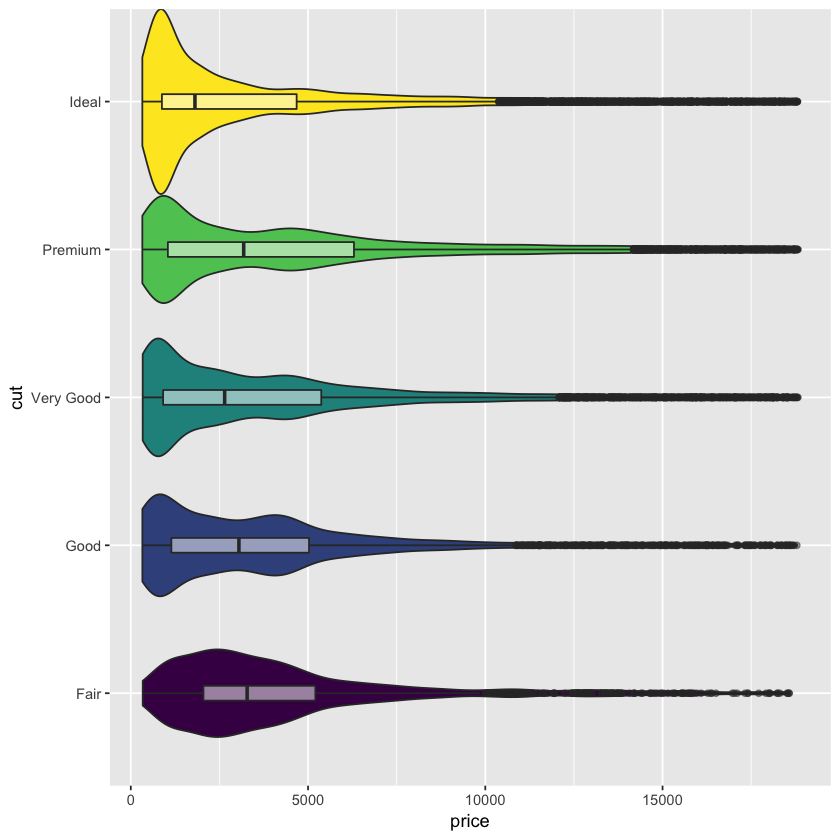

In [51]:
ggplot(diamonds, aes(cut, price)) + 
geom_violin(aes(fill = cut), width = 1.25) + 
geom_boxplot(width = 0.1, alpha = 0.5) + 
theme(legend.position = "none") + 
coord_flip()

## Outliers and missing data 

### Detecting outliers

Both boxplots and scatterplots are useful for detecting deviating observations - often called outliers. Outliers can be caused by measurement errors or errors in the data input, but can also be interesting rare cases that can provide valuable insights about the process that generated the data. Either way, it is often of interest to detect outliers, for instance because that may influence the choice of what statistical tests to use.

Let’s return to the scatterplot of diamond carat versus price:

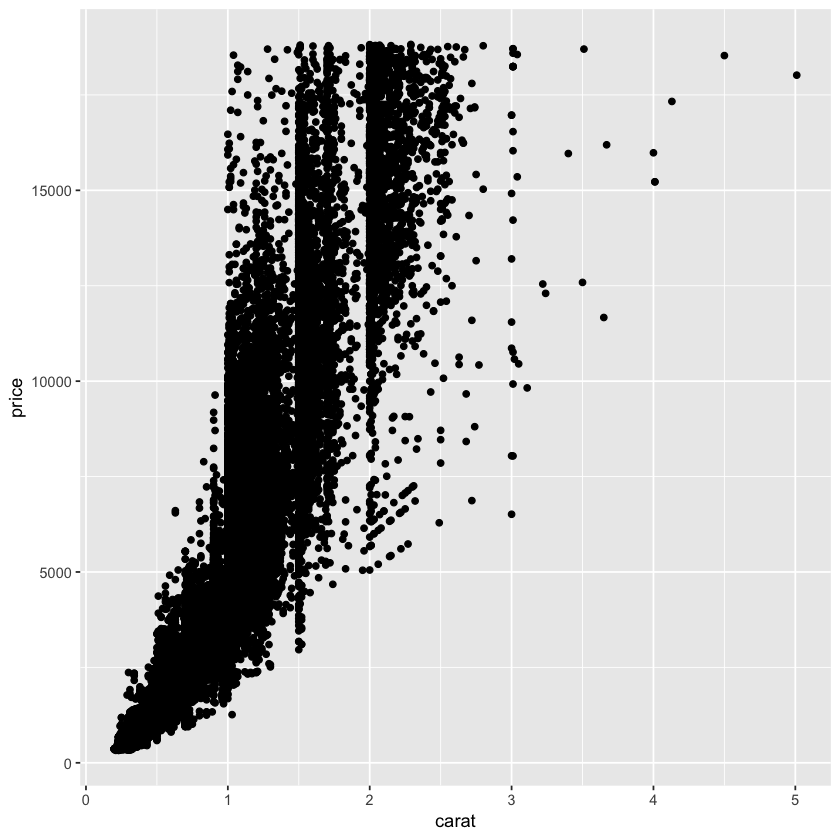

In [52]:
ggplot(diamonds, aes(carat, price)) + geom_point()

There are some outliers which we may want to study further. For instance, there is a surprisingly cheap 5 carat diamond, and some cheap 3 carat diamonds. But how can we identify those points?


One option is to use plotly to make an interactive version of the plot, where we can hover interesting points to see more information about them:


In [53]:
myPlot <- ggplot(diamonds, aes(carat, price)) +
geom_point()

In [54]:
ggplotly(myPlot)

HTML widgets cannot be represented in plain text (need html)


By default, plotly only shows the carat and price of each diamond. But we can add more information to the box by adding a text aesthetic:


In [55]:
myPlot <- ggplot(diamonds, aes(carat, price, text = paste("Row:", rownames(diamonds)))) + geom_point()

In [56]:
ggplotly(myPlot)

HTML widgets cannot be represented in plain text (need html)

### Exercise 4 

The variables x and y in the diamonds data describe the length and width of the diamonds (in mm). Use an interactive scatterplot to identify outliers in these variables. Check prices, carat and other information and think about if any of the outliers can be due to data errors.

In [57]:
myPlot <- ggplot(diamonds, aes(x, y, text = paste("Row:", rownames(diamonds)))) + geom_point()

In [58]:
ggplotly(myPlot)

HTML widgets cannot be represented in plain text (need html)

There are outliers along the y-axis on rows 24,068 and 49,190. There are also some points for which x = 0. Examples include rows 11,183 and 49,558. It isn’t clear from the plot, but in total there are 8 such points, 7 of which have both x = 0 and y = 0. To view all such diamonds, you can use filter(diamonds, x==0). These observations must be due to data errors, since diamonds can’t have 0 width. The high y-values also seem suspicious - carat is a measure of diamond weight, and if these diamonds really were 10 times longer than others then we would probably expect them to have unusally high carat values as well (which they don’t).

### Labelling outliers

Interactive plots are great when exploring a dataset, but are not always possible to use in other contexts, e.g. for presentations. In these other cases, we can instead annotate the plot with notes about outliers. In computer exercise 2, we did this using annotate. Here we will use another approach, namely a geom called geom_text. For instance, we may want to add the row numbers of outliers to a plot.


To do so, we use geom_text along with a condition that specifies which points we should add annota- tions for. We use ifelse(condition, what text to write if condition is satisfied, what text to write else). To add row names for observations that satisfy the condition but not for other observations, we use ifelse(condition, rownames(diamonds), ""). If instead we wanted to print the price of the diamonds, we’d use ifelse(condition, price, "") instead.


Here are some different examples of conditions used to plot text:

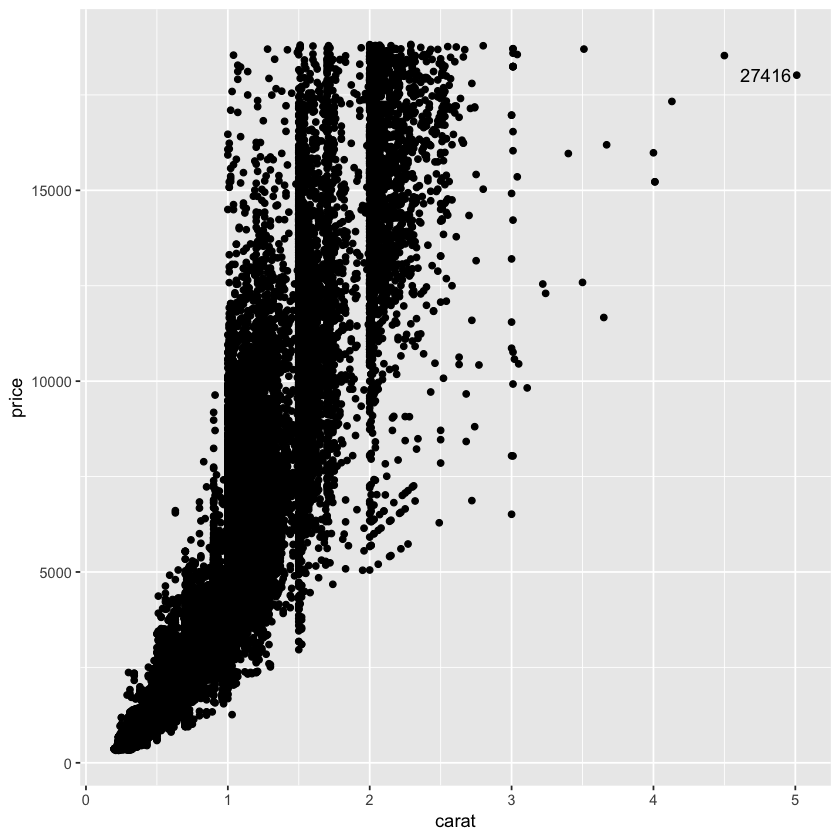

In [59]:
# Using the row number (the 5 carat diamond is on row 27,416)

ggplot(diamonds, aes(carat, price)) + geom_point() +
geom_text(aes(label = ifelse(rownames(diamonds) == 27416, rownames(diamonds), "")), hjust = 1.1)
bb
# (hjust=1.1 shifts the text to the left of the point)

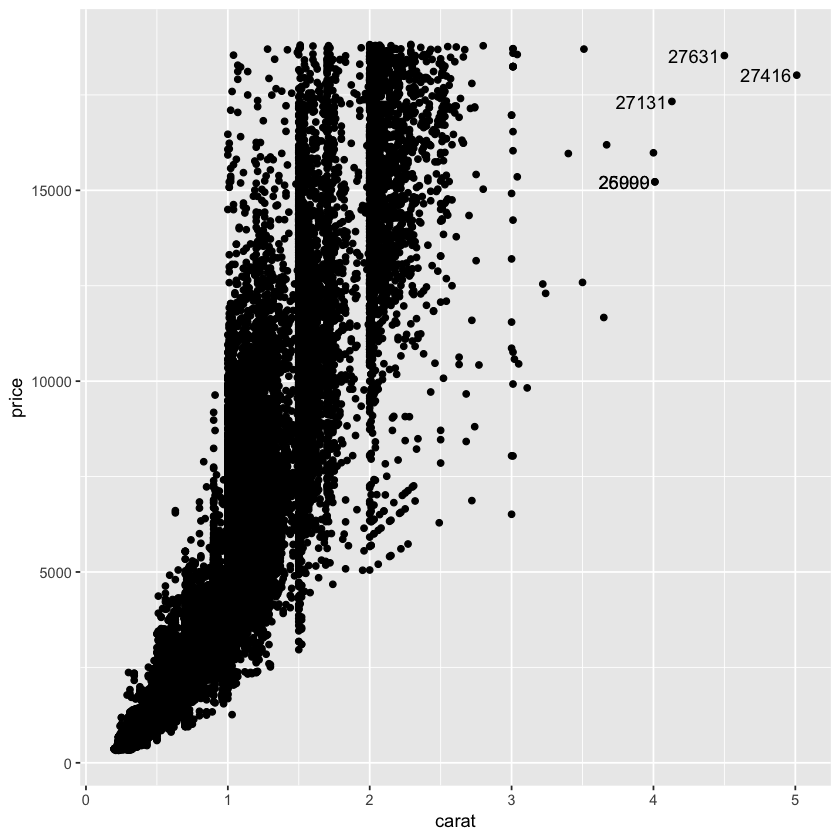

In [60]:
# Plot text next to all diamonds with carat>4
ggplot(diamonds, aes(carat, price)) + geom_point() +
geom_text(aes(label = ifelse(carat > 4, rownames(diamonds), "")), hjust = 1.1)

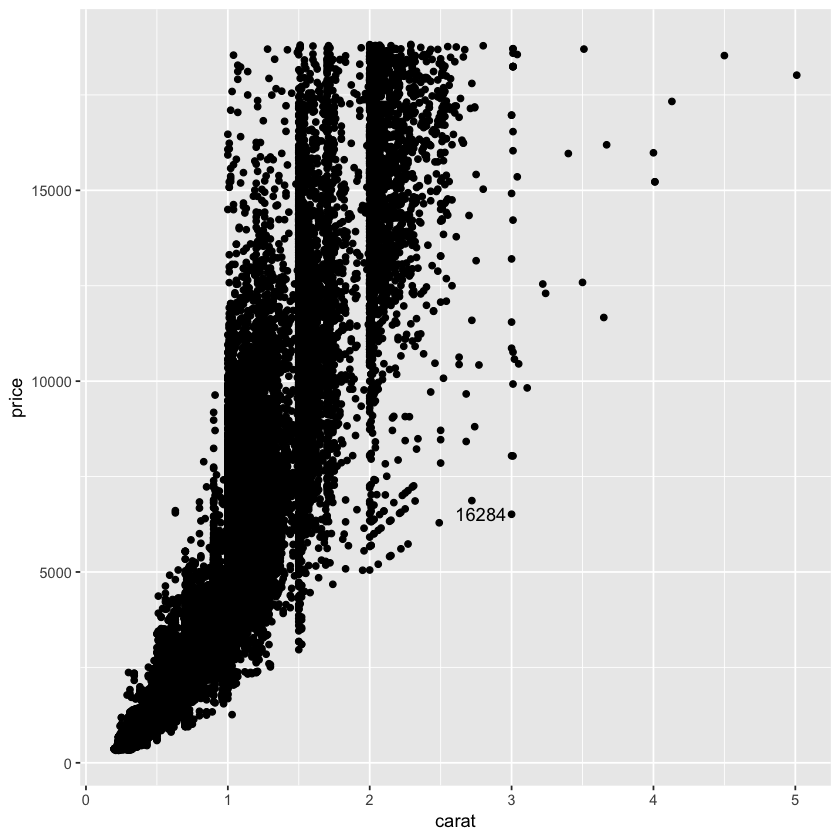

In [61]:
# Plot text next to 3 carat diamonds with a price below 7500
ggplot(diamonds, aes(carat, price)) + geom_point() +
geom_text(aes(label = ifelse(carat == 3 & price < 7500, rownames(diamonds), "")), hjust = 1.1)

### Exercise 5

Create a static (i.e. non-interactive) scatterplot of x versus y from the diamonds data. Label the diamonds with suspiciously high y-values.

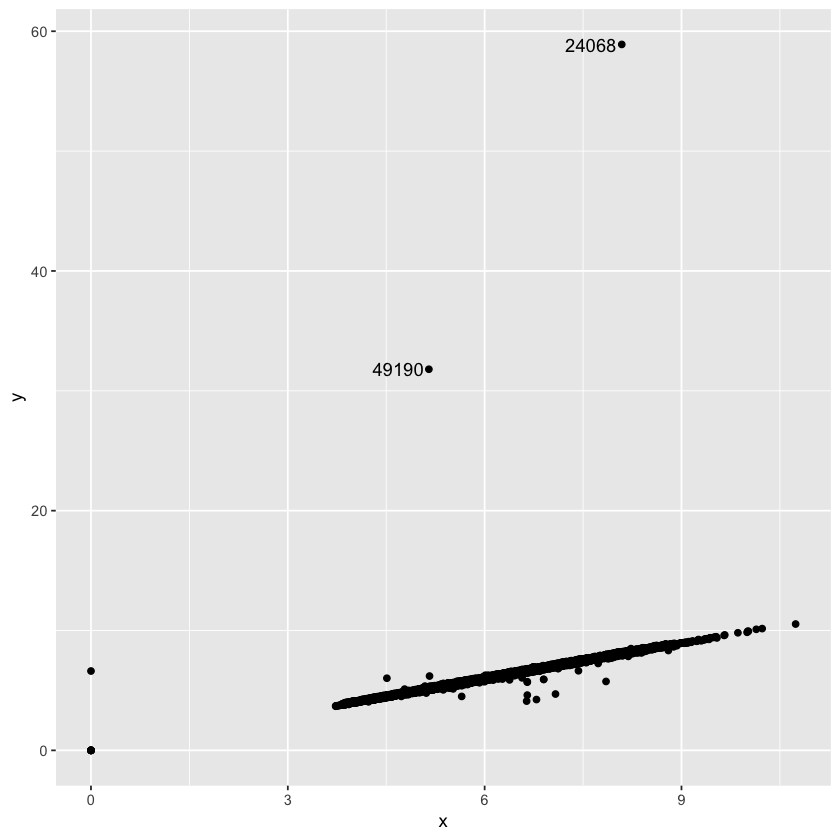

In [62]:
ggplot(diamonds, aes(x, y)) + geom_point() +
geom_text(aes(label = ifelse(y > 20, rownames(diamonds), "")), hjust = 1.1)

### Missing data

Like many datasets, the mammal sleep data msleep contains a lot of missing values, represented by NA (not 2
available) in R . This becomes evident when we have a look at the data:

In [63]:
View(msleep)

ERROR: Error in View(msleep): ‘View()’ not yet supported in the Jupyter R kernel


We can check if a particular observation is missing using the is.na function. In total there are 136 missing
values in the dataset. We can count the number of missing values for each variable using:

In [65]:
colSums(is.na(msleep))

name        genus         vore        order conservation  sleep_total 
           0            0            7            0           29            0 
   sleep_rem  sleep_cycle        awake      brainwt       bodywt 
          22           51            0           27            0

You’ll notice that ggplot2 prints a warning in the console when you create a plot with missing data:

Warning message:
“Removed 27 rows containing missing values (geom_point).”

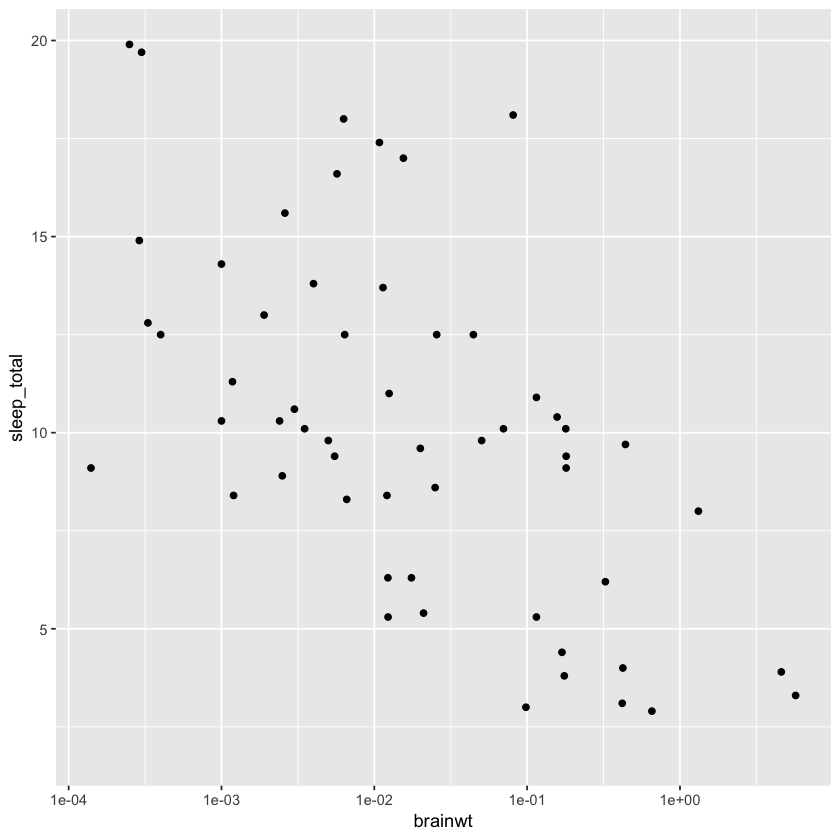

In [66]:
ggplot(msleep, aes(brainwt, sleep_total)) + geom_point() +
scale_x_log10()

Sometimes data are missing simply because the information is not yet available (for instance, the brain weight of the mountain beaver could be missing because no one has ever weighed the brain of a mountain beaver). In other cases, data can be missing because something about them are different (for instance, values for a male patient in a medical trial can be missing because the patient died, or because some values only were collected for female patients). It is therefore of interest to see if there are any differences in non-missing variables between subjects that have missing data and subjects that don’t.


In msleep, all animals have values for sleep_total and bodywt. To check if the animals that have missing brainwt values differ from the others, we can plot them in a different colour in a scatterplot:

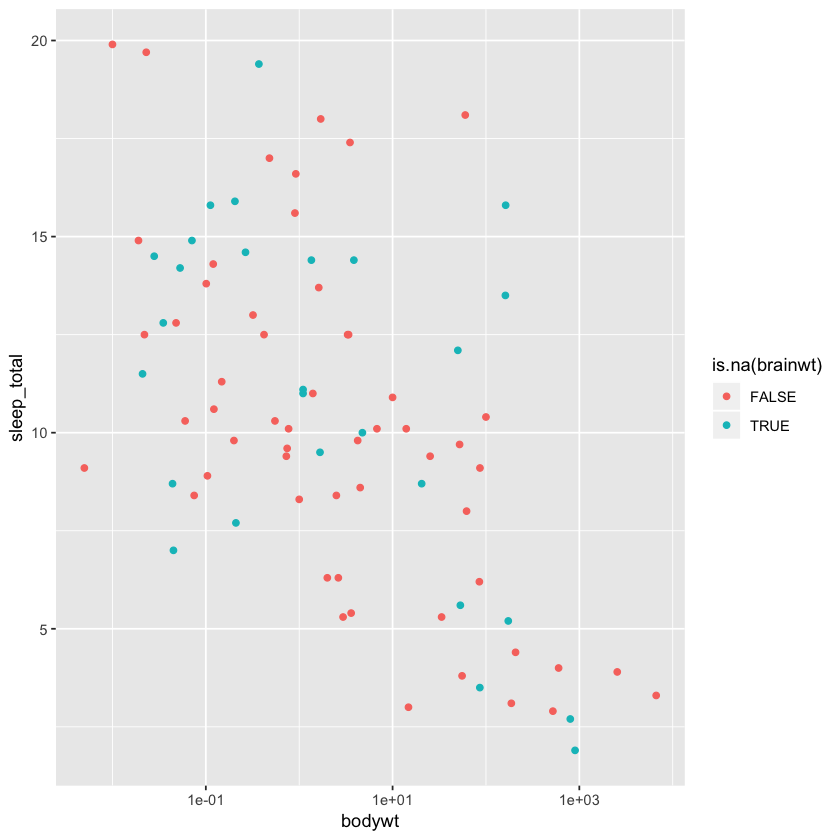

In [67]:
ggplot(msleep, aes(bodywt, sleep_total, colour = is.na(brainwt))) + geom_point() +
scale_x_log10()

(If is.na(brainwt) is TRUE then the brain weight is missing in the dataset.) In this case, there are no obvious differences between the animals with missing data and those without.

### Exercise 6

Create a version of the diamonds dataset where the x value is missing for all diamonds with x > 9. Make a scatterplot of carat versus price, with points where the x value is missing plotted in a different colour. How would you interpret this plot?

In [68]:
# Using mutate from the dplyr package
diamonds2 <- mutate(diamonds, x = ifelse(x > 9, NA, x))

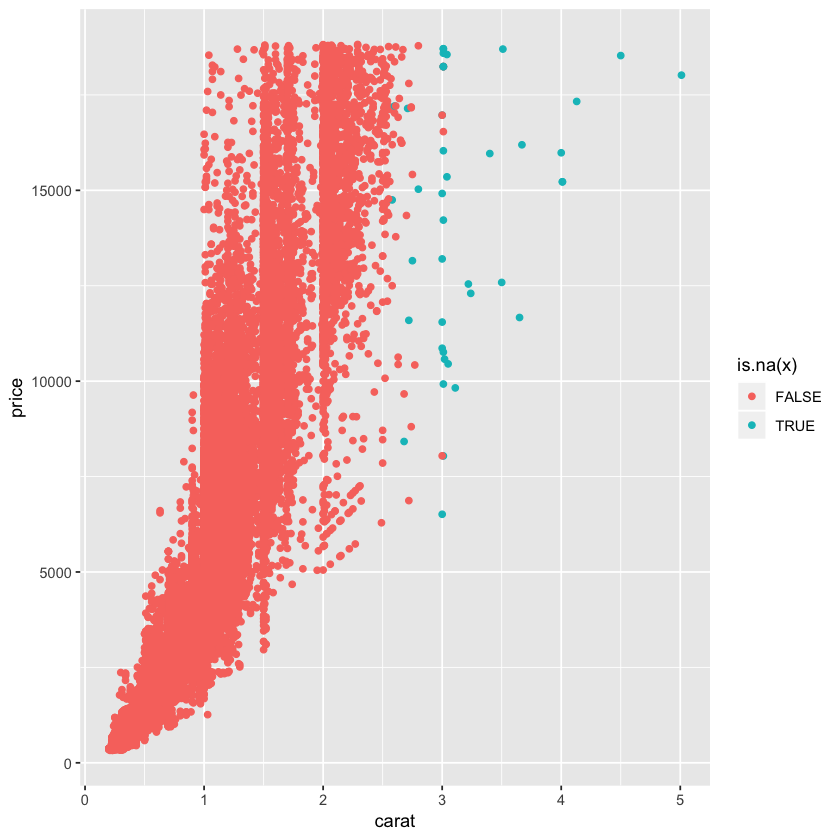

In [69]:
# Create the scatterplot
ggplot(diamonds2, aes(carat, price, colour = is.na(x))) + geom_point()

In this plot, we see that virtually all high carat diamonds have missing x values. This seems to indicate that there is a systematic pattern to the missing data (which of course is correct in this case!), and we should proceed with any analyses of x with caution.

### Exploring data

The nycflights13 package contains data about flights to and from three airports in New York, USA. As a final summary exercise, we will study a subset of these, namely all flights departing New York on 1 January that year.

In [71]:
flights2 <- filter(flights, month == 1 & day == 1)

### Exercise 7

Explore the flights2 dataset, focusing on delays and amount of time spent in the air. Are there any differences between the different carriers? Are there missing data? Are there any outliers?

In [72]:
# Investigate missing data
colSums(is.na(flights2))

year          month            day       dep_time sched_dep_time 
             0              0              0              4              0 
     dep_delay       arr_time sched_arr_time      arr_delay        carrier 
             4              5              0             11              0 
        flight        tailnum         origin           dest       air_time 
             0              0              0              0             11 
      distance           hour         minute      time_hour 
             0              0              0              0

In [73]:
# Not too much missing data in this dataset!
View(filter(flights2, is.na(air_time)))
# Flights with missing data tend to have several missing variables.

ERROR: Error in View(filter(flights2, is.na(air_time))): ‘View()’ not yet supported in the Jupyter R kernel


In [ ]:
# Ridge plots to compare different carriers (boxplots, facetted histograms and violin # plots could also be used)
ggplot(flights2, aes(arr_delay, carrier, fill = carrier)) +
geom_density_ridges() + theme(legend.position = "none") + xlim(-50, 250)
# Some airlines (e.g. EV) appear to have a larger spread than others
ggplot(flights2, aes(dep_delay, carrier, fill = carrier)) + geom_density_ridges() +
theme(legend.position = "none") +
xlim(-15, 100)
# Some airlines (e.g. EV) appear to have a larger spread others

In [ ]:
ggplot(flights2, aes(air_time, carrier, fill = carrier)) + geom_density_ridges() +
theme(legend.position = "none")
# VX only do long-distance flights, whereas MQ, FL and 9E only do shorter flights
# Make scatterplots and label outliers with flight numbers
ggplot(flights2, aes(dep_delay, arr_delay, colour = carrier)) + geom_point() +
geom_text(aes(label = ifelse(arr_delay > 300, paste("Flight", flight), "")), vjust = 1.2, hjust = 1)
ggplot(flights2, aes(air_time, arr_delay, colour = carrier)) + geom_point() +
geom_text(aes(label = ifelse(air_time > 400 | arr_delay > 300, paste("Flight", flight), "")),
vjust = 1.2, hjust = 1)